In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import warnings
warnings.filterwarnings("ignore")

In [2]:
# Load the dataset
df = pd.read_csv("ifood_df.csv")
# Display the first few rows of the dataset
print(df.head())
# Get a summary of the dataset
print(df.info())

    Income  Kidhome  Teenhome  Recency  MntWines  MntFruits  MntMeatProducts  \
0  58138.0        0         0       58       635         88              546   
1  46344.0        1         1       38        11          1                6   
2  71613.0        0         0       26       426         49              127   
3  26646.0        1         0       26        11          4               20   
4  58293.0        1         0       94       173         43              118   

   MntFishProducts  MntSweetProducts  MntGoldProds  ...  marital_Together  \
0              172                88            88  ...                 0   
1                2                 1             6  ...                 0   
2              111                21            42  ...                 1   
3               10                 3             5  ...                 1   
4               46                27            15  ...                 0   

   marital_Widow  education_2n Cycle  education_Basic  e

In [7]:
# Check for missing values
print(df.isnull().sum())

Income                  0
Kidhome                 0
Teenhome                0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
Age                     0
Customer_Days           0
marital_Divorced        0
marital_Married         0
marital_Single          0
marital_Together        0
marital_Widow           0
education_2n Cycle      0
education_Basic         0
education_Graduation    0
education_Master        0
education_PhD           0
MntTotal                0
MntRegularProds         0
AcceptedCmpO

In [9]:
# Fill missing values if any, or drop them
df = df.dropna()
# Display descriptive statistics
print(df.describe())

              Income      Kidhome     Teenhome      Recency     MntWines  \
count    2205.000000  2205.000000  2205.000000  2205.000000  2205.000000   
mean    51622.094785     0.442177     0.506576    49.009070   306.164626   
std     20713.063826     0.537132     0.544380    28.932111   337.493839   
min      1730.000000     0.000000     0.000000     0.000000     0.000000   
25%     35196.000000     0.000000     0.000000    24.000000    24.000000   
50%     51287.000000     0.000000     0.000000    49.000000   178.000000   
75%     68281.000000     1.000000     1.000000    74.000000   507.000000   
max    113734.000000     2.000000     2.000000    99.000000  1493.000000   

         MntFruits  MntMeatProducts  MntFishProducts  MntSweetProducts  \
count  2205.000000      2205.000000      2205.000000       2205.000000   
mean     26.403175       165.312018        37.756463         27.128345   
std      39.784484       217.784507        54.824635         41.130468   
min       0.000000 

In [11]:
# Drop non-numeric columns that may not be relevant for clustering
# Adjust based on your dataset's structure
df = df.select_dtypes(include=[np.number])

In [13]:
# Standardize the features
scaler = StandardScaler()
scaled_df = scaler.fit_transform(df)

In [15]:
# Example assuming columns names were identified as 'Total_Spend' and 'Purchase_Count'
average_purchase = df['Total_Spend'].mean() if 'Total_Spend' in df.columns else "Column not found"
purchase_frequency = df['Purchase_Count'].mean() if 'Purchase_Count' in df.columns else "Column not found"
# Display the calculated metrics or errors if columns were not found
print(f'Average Purchase Value: {average_purchase}')
print(f'Average Purchase Frequency: {purchase_frequency}')

Average Purchase Value: Column not found
Average Purchase Frequency: Column not found


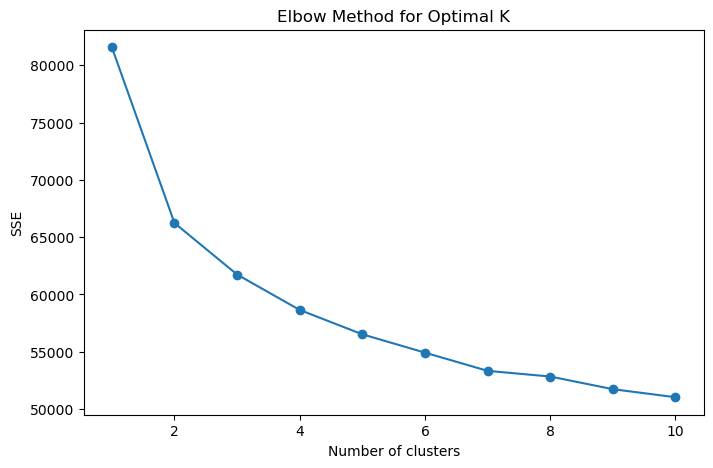

In [17]:
# Elbow method to determine the optimal number of clusters
sse = []
k_range = range(1, 11)
for k in k_range:
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(scaled_df)
sse.append(kmeans.inertia_)
# Plot SSE to visualize the elbow
plt.figure(figsize=(8, 5))
plt.plot(k_range, sse, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('SSE')
plt.title('Elbow Method for Optimal K')
plt.show()

In [20]:
# Compute silhouette score for K values and visualize
for k in range(2, 11):
kmeans = KMeans(n_clusters=k, random_state=42)
labels = kmeans.fit_predict(scaled_df)
silhouette_avg = silhouette_score(scaled_df, labels)
print(f'For n_clusters={k}, the silhouette score is {silhouette_avg}')

For n_clusters=2, the silhouette score is 0.2061759874438349
For n_clusters=3, the silhouette score is 0.17039707711393529
For n_clusters=4, the silhouette score is 0.12045662485539131
For n_clusters=5, the silhouette score is 0.11880059864803322
For n_clusters=6, the silhouette score is 0.07000032226572185
For n_clusters=7, the silhouette score is 0.07342314858551215
For n_clusters=8, the silhouette score is 0.06840288453236712
For n_clusters=9, the silhouette score is 0.07441241323456933
For n_clusters=10, the silhouette score is 0.07003757383484845


In [22]:
# Final K-means clustering with chosen number of clusters
kmeans = KMeans(n_clusters=4, random_state=42)
df['Cluster'] = kmeans.fit_predict(scaled_df)

In [21]:
# Pairplot to see cluster separation (modify features as needed)
sns.pairplot(df, hue='Cluster', palette='viridis')
plt.show()

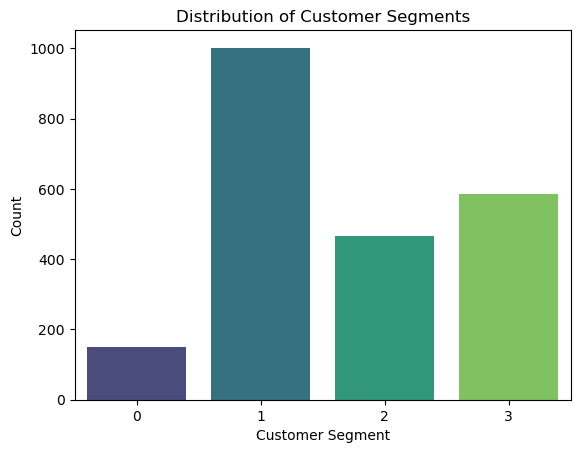

In [23]:
# Distribution of clusters
sns.countplot(x='Cluster', data=df, palette='viridis')
plt.title('Distribution of Customer Segments')
plt.xlabel('Customer Segment')
plt.ylabel('Count')
plt.show()

In [27]:
from sklearn.decomposition import PCA

# Reduce to 2 dimensions for visualization
pca = PCA(n_components=2)
pca_df = pca.fit_transform(scaled_df)
pca_df = pd.DataFrame(pca_df, columns=['PCA1', 'PCA2'])
pca_df['Cluster'] = df['Cluster']

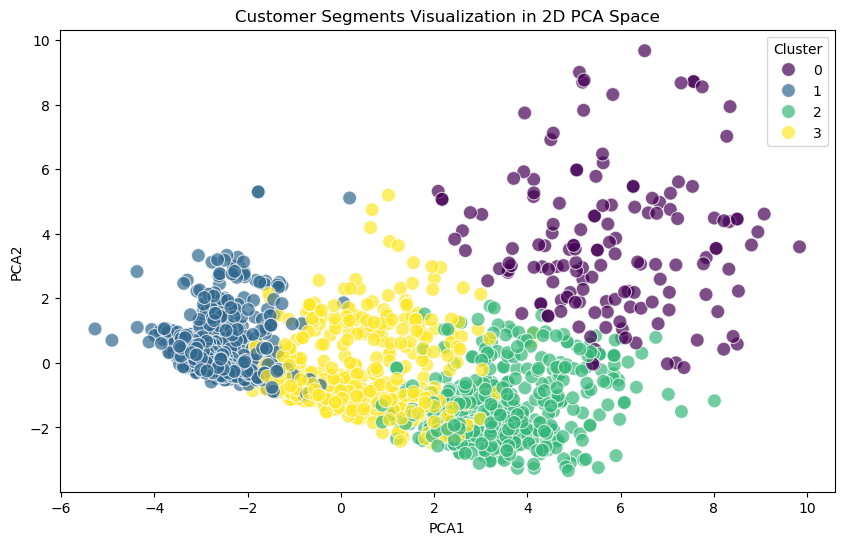

In [29]:
# Scatter plot for clusters in 2D
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PCA1', y='PCA2', hue='Cluster', palette='viridis', s=100, alpha=0.7)
plt.title('Customer Segments Visualization in 2D PCA Space')
plt.show()

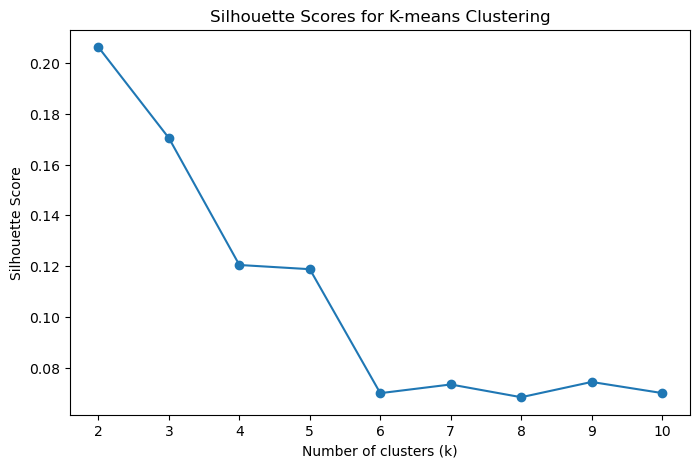

In [31]:
### Silhouette Scores for each cluster ###
silhouette_scores = []
for k in range(2, 11):
kmeans = KMeans(n_clusters=k, random_state=42)
labels = kmeans.fit_predict(scaled_df)
silhouette_scores.append(silhouette_score(scaled_df, labels))

plt.figure(figsize=(8, 5))
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Scores for K-means Clustering')
plt.show()

In [41]:
# Compute the mean values for each cluster
cluster_summary = df.groupby('Cluster').mean()
print(cluster_summary)

               Income   Kidhome  Teenhome    Recency    MntWines  MntFruits  \
Cluster                                                                       
0        80508.730233  0.046512  0.153488  48.967442  855.418605  57.688372   
1        36873.886700  0.730706  0.522989  48.478654   75.702791   5.884236   
2        66845.787565  0.097150  0.579016  49.857513  516.803109  50.063472   

         MntMeatProducts  MntFishProducts  MntSweetProducts  MntGoldProds  \
Cluster                                                                     
0             477.204651        87.134884         67.609302     75.134884   
1              31.901478         8.858785          5.787356     20.563218   
2             288.935233        69.597150         49.524611     72.468912   

         ...  marital_Together  marital_Widow  education_2n Cycle  \
Cluster  ...                                                        
0        ...          0.241860       0.051163            0.083721   
1        ..